In [1]:
%%HTML
<style>
    body {
        --vscode-font-family: "KoddiUD 온고딕"
    }
</style>

In [2]:
# 라이브러리 로드
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sns

pd.set_option('future.no_silent_downcasting', True)
#max_columns의 개수를 none으로 지정하면 column이 많아도 ...으로 표현되지 않고 전체 다 표현됨
pd.set_option('display.max_columns', None)
from utils import *
from utils2 import *

In [3]:
# 한글 폰트 설정

# pip install koreanize-matplotlib
import koreanize_matplotlib

%config InlineBackend.figure_format = 'retina'

# 0. 데이터 불러오기

- 데이터 출처
  - [Kaggle](https://www.kaggle.com/datasets/olistbr/brazilian-ecommerce/data) `Brazilian E-Commerce Public Dataset by Olist`
- 데이터 명세
  - customers_df
  
    |컬럼 이름|	데이터 타입|	설명|
    |-------|--------|------|
    |customer_id| VARCHAR|	고객 고유 식별자|
    |customer_unique_id|	VARCHAR|	고객의 고유 ID|
    |customer_zip_code_prefix	|INT	|고객의 우편번호 앞부분|
    |customer_city|	VARCHAR|	고객의 도시 정보|
    |customer_state	|VARCHAR	|고객의 주 정보|
  
  - items_df

    | 컬럼 이름              | 데이터 타입 | 설명                             |
    |------------------------|-------------|----------------------------------|
    | order_id               | VARCHAR     | 주문 고유 식별자                   |
    | order_item_id          | INT         | 주문 내에서의 각 상품의 식별자       |
    | product_id             | VARCHAR     | 상품 고유 식별자                   |
    | seller_id              | VARCHAR     | 판매자 고유 식별자                 |
    | shipping_limit_date    | TIMESTAMP   | 판매자가 상품을 발송해야 하는 마감일 |
    | price                  | FLOAT       | 주문된 상품의 가격                 |
    | freight_value          | FLOAT       | 
    
  - payments_df

    | 컬럼 이름            | 데이터 타입 | 설명                          |
    |----------------------|-------------|-------------------------------|
    | order_id             | VARCHAR     | 주문 고유 식별자               |
    | payment_sequential   | INT         | 각 주문의 결제 수단 순서 ,고객이 한 주문에 대해 여러 결제 수단을 사용할 수 있습니다. 이 경우 각 결제 수단에 순번이 매겨집니다.       |
    | payment_type         | VARCHAR     | 결제 방식 (신용카드, 현금 등)  |
    | payment_installments | INT         | 할부 개월 수                   |
    | payment_value        | FLOAT       | 결제 금액                      |

  - reviews_df
  
    | 컬럼 이름                | 데이터 타입 | 설명                     |
    |--------------------------|-------------|--------------------------|
    | review_id                | VARCHAR     | 리뷰 고유 식별자         |
    | order_id                 | VARCHAR     | 리뷰와 연결된 주문 고유 식별자 |
    | review_score             | INT         | 고객이 남긴 평점         |
    | review_comment_title     | VARCHAR     | 리뷰 제목                |
    | review_comment_message   | TEXT        | 리뷰 내용                |
    | review_creation_date     | TIMESTAMP   | 만족도 조사가 고객에게 전송된 시각       |
    | review_answer_timestamp  | TIMESTAMP   | 만족도 조사에 답변한 시각       |

  - orders_df

    | 컬럼 이름                      | 데이터 타입 | 설명                             |
    |--------------------------------|-------------|----------------------------------|
    | order_id                       | VARCHAR     | 주문 고유 식별자                   |
    | customer_id                    | VARCHAR     | Customers 테이블과 연결되는 고객 식별자    |
    | order_status                   | VARCHAR     | 주문 상태 (배송 완료, 결제 완료 등)  |
    | order_purchase_timestamp       | TIMESTAMP   | 고객이 주문한 시각                |
    | order_delivered_carrier_date   | TIMESTAMP   | 운송사가 배송을 시작한 시각         |
    | order_delivered_customer_date  | TIMESTAMP   | 고객에게 최종 배송된 날짜           |
    | order_estimated_delivery_date  | TIMESTAMP   | 예상 배송 날짜                    |
    | order_approved_at  | TIMESTAMP   | 주문이 결제 승인된 날짜 및 시간                   |

  - products_df
  
    | 컬럼 이름                   | 데이터 타입 | 설명                    |
    |-----------------------------|-------------|-------------------------|
    | product_id                  | VARCHAR     | 상품 고유 식별자         |
    | product_category_name       | VARCHAR     | 상품의 카테고리 이름     |
    | product_name_length         | INT         | 상품 이름의 길이         |
    | product_description_length  | INT         | 상품 설명의 길이         |
    | product_photos_qty          | INT         | 상품 사진의 개수         |
    | product_weight_g            | FLOAT       | 상품의 무게 (그램)       |
    | product_length_cm           | FLOAT       | 상품 길이 (센티미터)     |
    | product_height_cm           | FLOAT       | 상품 높이 (센티미터)     |
    | product_width_cm            | FLOAT       | 상품 폭 (센티미터)       |

  - sellers_df

    | 컬럼 이름               | 데이터 타입 | 설명                   |
    |-------------------------|-------------|------------------------|
    | seller_id               | VARCHAR     | 판매자 고유 식별자      |
    | seller_zip_code_prefix  | INT         | 판매자의 우편번호 앞부분 |
    | seller_city             | VARCHAR     | 판매자의 도시 정보      |
    | seller_state            | VARCHAR     | 판매자의 주 정보        |



In [4]:
customers_df = pd.read_csv('data/olist_customers_dataset.csv')
items_df = pd.read_csv('data/olist_order_items_dataset.csv')
payments_df = pd.read_csv('data/olist_order_payments_dataset.csv')
reviews_df = pd.read_csv('data/olist_order_reviews_dataset.csv')
orders_df = pd.read_csv('data/olist_orders_dataset.csv')
products_df = pd.read_csv('data/olist_products_dataset.csv')
sellers_df = pd.read_csv('data/olist_sellers_dataset.csv')
category_df = pd.read_csv('data/product_category_name_translation.csv')


# 1. 데이터 살펴보기

## 1.1 데이터 기본 정보 확인

In [5]:
# Basic EDA
basic_eda_result = {}
def basic_eda(df):
  summary = {
        'info': df.info,
        'shape': df.shape,
        'columns': df.columns.tolist(),
        'describe': df.describe(include = 'all'),
        'head': df.head().to_dict(orient='records'),
        'missing values': df.isnull().sum().to_dict(),
        'duplicated values': df.duplicated().sum()
    }
  return summary
basic_eda_result['customers'] = basic_eda(customers_df)
basic_eda_result['items'] = basic_eda(items_df)
basic_eda_result['payments'] = basic_eda(payments_df)
basic_eda_result['reviews'] = basic_eda(reviews_df)
basic_eda_result['orders'] = basic_eda(orders_df)
basic_eda_result['products'] = basic_eda(products_df)
basic_eda_result['sellers'] = basic_eda(sellers_df)

basic_eda_result

{'customers': {'info': <bound method DataFrame.info of                             customer_id                customer_unique_id  \
  0      06b8999e2fba1a1fbc88172c00ba8bc7  861eff4711a542e4b93843c6dd7febb0   
  1      18955e83d337fd6b2def6b18a428ac77  290c77bc529b7ac935b93aa66c333dc3   
  2      4e7b3e00288586ebd08712fdd0374a03  060e732b5b29e8181a18229c7b0b2b5e   
  3      b2b6027bc5c5109e529d4dc6358b12c3  259dac757896d24d7702b9acbbff3f3c   
  4      4f2d8ab171c80ec8364f7c12e35b23ad  345ecd01c38d18a9036ed96c73b8d066   
  ...                                 ...                               ...   
  99436  17ddf5dd5d51696bb3d7c6291687be6f  1a29b476fee25c95fbafc67c5ac95cf8   
  99437  e7b71a9017aa05c9a7fd292d714858e8  d52a67c98be1cf6a5c84435bd38d095d   
  99438  5e28dfe12db7fb50a4b2f691faecea5e  e9f50caf99f032f0bf3c55141f019d99   
  99439  56b18e2166679b8a959d72dd06da27f9  73c2643a0a458b49f58cea58833b192e   
  99440  274fa6071e5e17fe303b9748641082c8  84732c5050c01db9b23e19ba39899398   

- 테이블별 특성 파악
  - **customers_dataset**
    - 고객 정보
    - 주요 컬럼
      - customer_id, customer_unique_id, customer_zip_code_prefixm, customer_city, customer_state
    - 특징
      - 99,441명의 고객 정보가 있고 96,096명의 고유 고객
      - 상파울로가 가장 많은 고객이 있는 도시(15,540명)
      - SP주가 가장 많은 고객이 있는 주(41,746명)
  - **order_items_dataset**
    - 주문 아이템에 대한 정보
    - 주요 컬럼
      - order_id, order_item_id, product_id, seller_id, price, freight_value
    - 특징
      - 각 주문(order_id)에 대한 개별 아이템 정보 제공
      - 가격(price)과 배송비(freight_value) 정보 포함하고 있음
  - **order_payments_dataset**
    - 주문 결제 정보
    - 주요 컬럼
      - order_id, payment_sequential, payment_type, payment_installments, payment_value
    - 특징
      - 결제 방식과 금액 정보 제공
      - 결제 방식 중 신용카드가 가장 많이 사용됨(76,795건)
      - 평균 결제 금액은 154.10, 최대는 13,664.08
  - **order_reviews_dataset**
    - 주문에 대한 리뷰 정보
    - 주요 컬럼
      - review_id, order_id, review_score, review_comment_title, review_comment_message
    - 특징
      - 99,224개의 리뷰
      - 평균 리뷰 점수는 4.09/5
      - 11,568개의 리뷰 제목과 40,977개의 리뷰 내용이 있음
  - **orders_dataset**
    - 주문에 대한 전반적인 정보
    - 주요 컬럼
      - order_id, customer_id, order_status, order_purchase_timestamp, order_delivered_customer_date
    - 특징
      - 주문의 전체 라이프사이클 추적 가능
      - 주문 상태와 배송 일정 정보가 포함되어 있음
  - **product_dataset**
    - 제품 정보
    - 주요 컬럼
      - product_id, product_category_name, product_name_length, product_description_lengt, product_photos_qty
    - 특징
      - 32,961개의 제품
      - 73개의 제품 카테고리
      - 'cama_mesa_banho'가 가장 많은 제품을 가진 카테고리(3,029개)
      - 평균 제품 사진 수 2.19개
  - **sellers_dataset**
    - 판매자 정보
    - 주요 컬럼
      - seller_id, seller_zip_code_prefix, seller_city, seller_state
    - 특징
      - 판매자의 지리적 위치 정보 제공

- 테이블 간 관계
  - order_id
    - order_items_df, orders_df, payments_df, reviews_df 공통
  - customer_id
    - customers_df, orders_df 공통
  - product_id
    - products_df, items_df 공통
  - seller_id
    - sellers_df, items_df 공통 

## 1.2 결측치 시각화

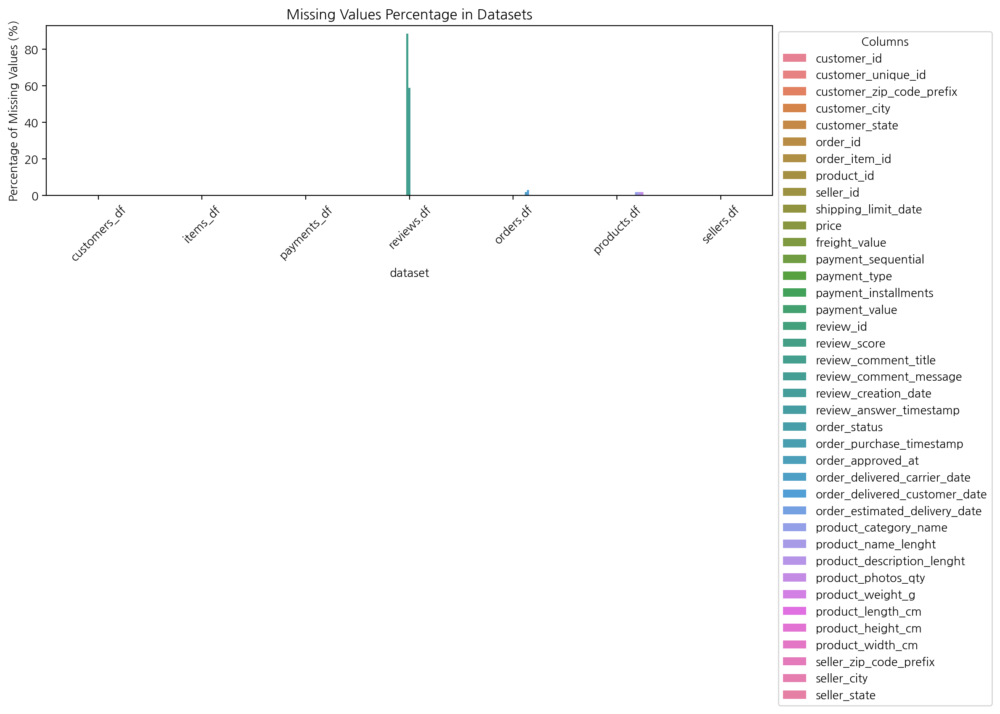

In [6]:
missing_customers = calculate_missing(customers_df)
missing_items = calculate_missing(items_df)
missing_payments = calculate_missing(payments_df)
missing_reviews = calculate_missing(reviews_df)
missing_orders = calculate_missing(orders_df)
missing_products = calculate_missing(products_df)
missing_sellers = calculate_missing(sellers_df)

# 시각화 위해 병합
missing_combined = pd.concat([missing_customers,missing_items,missing_payments, missing_reviews, missing_orders, missing_products, missing_sellers,], keys=['customers_df','items_df','payments_df','reviews.df', 'orders.df', 'products.df', 'sellers.df'])
missing_combined = missing_combined.reset_index().rename(columns={'level_0': 'dataset'})

# Plotting the missing values
plt.figure(figsize=(12, 6))
sns.barplot(data=missing_combined, x='dataset', y='percentage', hue='level_1')
plt.title('Missing Values Percentage in Datasets')
plt.ylabel('Percentage of Missing Values (%)')
plt.xticks(rotation=45)
plt.legend(title='Columns', bbox_to_anchor=(1, 1))
plt.tight_layout()
plt.show()

- 결측치
  - **products_df**
    - product_category_name
      - 610개 (1.85%)
    - product_name_lenght
      - 610개 (1.85%)
    - product_description_lenght
      - 610개 (1.85%)
    - product_photos_qty
      - 610개 (1.85%)
    - product_weight_g
      - 2개 (0.006%)
    - product_length_cm
      - 2개 (0.006%)
    - product_height_cm
      - 2개 (0.006%)
    - product_width_cm
      - 2개 (0.006%)
  - **reviews_df**
    - review_comment_title
      - 87,656개 (88.34%)
    - review comment_message
      - 58,247개 (58.70%)
  - **orders_df**
    - order_approved_at
      - 160개 (0.16%)
    - order_delivered_carrier_date
      - 1783개 (1.79%)
    - order_delivered_customer_date
      - 2965개 (2.98%)

# 2. 전처리

## 2.1 영어 카테고리명과 병합

In [7]:
# 데이터 병합
products_df = pd.merge(products_df, category_df, on='product_category_name', how='left')


In [8]:
products_df.head()

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,product_category_name_english
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,40.0,287.0,1.0,225.0,16.0,10.0,14.0,perfumery
1,3aa071139cb16b67ca9e5dea641aaa2f,artes,44.0,276.0,1.0,1000.0,30.0,18.0,20.0,art
2,96bd76ec8810374ed1b65e291975717f,esporte_lazer,46.0,250.0,1.0,154.0,18.0,9.0,15.0,sports_leisure
3,cef67bcfe19066a932b7673e239eb23d,bebes,27.0,261.0,1.0,371.0,26.0,4.0,26.0,baby
4,9dc1a7de274444849c219cff195d0b71,utilidades_domesticas,37.0,402.0,4.0,625.0,20.0,17.0,13.0,housewares


## 2.2 결측치 처리

**[products_df]**

- products의 결측치
  - product_category_name
    - 610개 (1.85%)
  - product_name_lenght
    - 610개 (1.85%)
  - product_description_lenght
    - 610개 (1.85%)
  - product_photos_qty
    - 610개 (1.85%)
  - 중복행의 결측치 &rarr; 삭제

In [9]:
products_df = products_df.dropna(subset=['product_category_name'])

In [10]:
missing_products = products_df[products_df.isnull().any(axis=1)]
missing_products

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,product_category_name_english
1628,0105b5323d24fc655f73052694dbbb3a,pc_gamer,59.0,621.0,4.0,2839.0,19.0,16.0,18.0,NaN
5821,6fd83eb3e0799b775e4f946bd66657c0,portateis_cozinha_e_preparadores_de_alimentos,52.0,280.0,1.0,1200.0,25.0,33.0,25.0,NaN
7325,5d923ead886c44b86845f69e50520c3e,portateis_cozinha_e_preparadores_de_alimentos,58.0,284.0,1.0,1200.0,25.0,33.0,25.0,NaN
7478,6727051471a0fc4a0e7737b57bff2549,pc_gamer,60.0,1532.0,3.0,650.0,16.0,22.0,20.0,NaN
8578,09ff539a621711667c43eba6a3bd8466,bebes,60.0,865.0,3.0,NaN,NaN,NaN,NaN,baby
8819,bed164d9d628cf0593003389c535c6e0,portateis_cozinha_e_preparadores_de_alimentos,54.0,382.0,2.0,850.0,30.0,21.0,22.0,NaN
11039,1220978a08a6b29a202bc015b18250e9,portateis_cozinha_e_preparadores_de_alimentos,46.0,280.0,1.0,1200.0,25.0,33.0,25.0,NaN
14266,ae62bb0f95af63d64eae5f93dddea8d3,portateis_cozinha_e_preparadores_de_alimentos,59.0,927.0,1.0,10600.0,40.0,20.0,38.0,NaN
16182,1954739d84629e7323a4295812a3e0ec,portateis_cozinha_e_preparadores_de_alimentos,58.0,792.0,4.0,750.0,30.0,30.0,30.0,NaN
16930,dbe520fb381ad695a7e1f2807d20c765,pc_gamer,60.0,840.0,6.0,800.0,18.0,22.0,22.0,NaN


product_category_name_english가 baby인 행 하나 삭제

In [11]:
products_df = products_df.dropna(subset=['product_weight_g'])

영문 이름 결측치 대체

In [12]:
products_df.loc[products_df['product_category_name'] == 'pc_gamer', 'product_category_name_english'] = 'pc_gamer'
products_df.loc[products_df['product_category_name'] == 'portateis_cozinha_e_preparadores_de_alimentos', 'product_category_name_english'] = 'portable kitchen and food preparers'

전체 브라질 상품명 영어로 대체

In [13]:
products_df = products_df.drop(columns=['product_category_name'])
products_df.rename(columns={'product_category_name_english': 'product_category_name'}, inplace=True)

In [14]:
products_df.isna().sum()

product_id                    0
product_name_lenght           0
product_description_lenght    0
product_photos_qty            0
product_weight_g              0
product_length_cm             0
product_height_cm             0
product_width_cm              0
product_category_name         0
dtype: int64

**[reviews_df]**

reviews_df의 결측치 "no comment"로 대체

In [15]:
reviews_df.fillna("No comment", inplace=True)

In [16]:
reviews_df.isna().sum()

review_id                  0
order_id                   0
review_score               0
review_comment_title       0
review_comment_message     0
review_creation_date       0
review_answer_timestamp    0
dtype: int64

In [17]:
reviews_df.head()

,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
0,7bc2406110b926393aa56f80a40eba40,73fc7af87114b39712e6da79b0a377eb,4,No comment,No comment,2018-01-18 00:00:00,2018-01-18 21:46:59
1,80e641a11e56f04c1ad469d5645fdfde,a548910a1c6147796b98fdf73dbeba33,5,No comment,No comment,2018-03-10 00:00:00,2018-03-11 03:05:13
2,228ce5500dc1d8e020d8d1322874b6f0,f9e4b658b201a9f2ecdecbb34bed034b,5,No comment,No comment,2018-02-17 00:00:00,2018-02-18 14:36:24
3,e64fb393e7b32834bb789ff8bb30750e,658677c97b385a9be170737859d3511b,5,No comment,Recebi bem antes do prazo estipulado.,2017-04-21 00:00:00,2017-04-21 22:02:06
4,f7c4243c7fe1938f181bec41a392bdeb,8e6bfb81e283fa7e4f11123a3fb894f1,5,No comment,Parabéns lojas lannister adorei comprar pela I...,2018-03-01 00:00:00,2018-03-02 10:26:53


**[orders_df]**

In [18]:
missing_orders = orders_df[orders_df.isnull().any(axis=1)]
missing_orders

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
6,136cce7faa42fdb2cefd53fdc79a6098,ed0271e0b7da060a393796590e7b737a,invoiced,2017-04-11 12:22:08,2017-04-13 13:25:17,NaN,NaN,2017-05-09 00:00:00
44,ee64d42b8cf066f35eac1cf57de1aa85,caded193e8e47b8362864762a83db3c5,shipped,2018-06-04 16:44:48,2018-06-05 04:31:18,2018-06-05 14:32:00,NaN,2018-06-28 00:00:00
103,0760a852e4e9d89eb77bf631eaaf1c84,d2a79636084590b7465af8ab374a8cf5,invoiced,2018-08-03 17:44:42,2018-08-07 06:15:14,NaN,NaN,2018-08-21 00:00:00
128,15bed8e2fec7fdbadb186b57c46c92f2,f3f0e613e0bdb9c7cee75504f0f90679,processing,2017-09-03 14:22:03,2017-09-03 14:30:09,NaN,NaN,2017-10-03 00:00:00
154,6942b8da583c2f9957e990d028607019,52006a9383bf149a4fb24226b173106f,shipped,2018-01-10 11:33:07,2018-01-11 02:32:30,2018-01-11 19:39:23,NaN,2018-02-07 00:00:00
...,...,...,...,...,...,...,...,...
99283,3a3cddda5a7c27851bd96c3313412840,0b0d6095c5555fe083844281f6b093bb,canceled,2018-08-31 16:13:44,NaN,NaN,NaN,2018-10-01 00:00:00
99313,e9e64a17afa9653aacf2616d94c005b8,b4cd0522e632e481f8eaf766a2646e86,processing,2018-01-05 23:07:24,2018-01-09 07:18:05,NaN,NaN,2018-02-06 00:00:00
99347,a89abace0dcc01eeb267a9660b5ac126,2f0524a7b1b3845a1a57fcf3910c4333,canceled,2018-09-06 18:45:47,NaN,NaN,NaN,2018-09-27 00:00:00
99348,a69ba794cc7deb415c3e15a0a3877e69,726f0894b5becdf952ea537d5266e543,unavailable,2017-08-23 16:28:04,2017-08-28 15:44:47,NaN,NaN,2017-09-15 00:00:00


- 배송이 완료되지 않은 경우라 날짜는 비워져있을 수 밖에 없는 것으로 확인됨

# 3. 테이블별 EDA

## 3.1 customers_df

테이블 별 구성 재확인

In [19]:
customers_df.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP


- customer_unique__id
  - 고객의 고유 아이디
- customer_id
  - 주문할 때마다 생성되는 고객 아이디

In [20]:
customers_df['customer_unique_id'].nunique()

96096

시각화

In [21]:
plot_count_plot(customers_df, 'customer_city')

In [22]:
count_sao_paulo = customers_df[customers_df['customer_city'] == 'sao paulo'].shape[0]
total_orders = orders_df.shape[0]

percentage_sao_paulo = (count_sao_paulo / total_orders) * 100
percentage_sao_paulo

15.627356925211936

- 'sao paulo'가 약 15.6%로 가장 많은 고객들이 거주하는 도시

In [23]:
plot_count_plot(customers_df, 'customer_state')

In [24]:
count_SP = customers_df[customers_df['customer_state'] == 'SP'].shape[0]
total_orders = orders_df.shape[0]

percentage_SP = (count_SP / total_orders) * 100
percentage_SP

41.980671956235355

- SP 주에 거주 중인 사람이 41.746k명, 41.98%로 가장 많음

## 3.2 items_df

구성 재확인

In [25]:
items_df.head()

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.90,13.29
1,00018f77f2f0320c557190d7a144bdd3,1,e5f2d52b802189ee658865ca93d83a8f,dd7ddc04e1b6c2c614352b383efe2d36,2017-05-03 11:05:13,239.90,19.93
2,000229ec398224ef6ca0657da4fc703e,1,c777355d18b72b67abbeef9df44fd0fd,5b51032eddd242adc84c38acab88f23d,2018-01-18 14:48:30,199.00,17.87
3,00024acbcdf0a6daa1e931b038114c75,1,7634da152a4610f1595efa32f14722fc,9d7a1d34a5052409006425275ba1c2b4,2018-08-15 10:10:18,12.99,12.79
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,ac6c3623068f30de03045865e4e10089,df560393f3a51e74553ab94004ba5c87,2017-02-13 13:57:51,199.90,18.14


시각화

In [26]:
plot_histogram(items_df, 'price')

In [27]:
plot_boxplot(items_df, 'price')

- 중앙값 74.99 달러
- 6735달러, 6499달러의 비싼 상품도 있음

In [28]:
plot_histogram(items_df, 'freight_value')

In [29]:
plot_boxplot(items_df, 'freight_value')

- 가격 분포와 비슷하게 나타남

## 3.3 payments_df

구성 재확인

In [30]:
payments_df.head()

,order_id,payment_sequential,payment_type,payment_installments,payment_value
0,b81ef226f3fe1789b1e8b2acac839d17,1,credit_card,8,99.33
1,a9810da82917af2d9aefd1278f1dcfa0,1,credit_card,1,24.39
2,25e8ea4e93396b6fa0d3dd708e76c1bd,1,credit_card,1,65.71
3,ba78997921bbcdc1373bb41e913ab953,1,credit_card,8,107.78
4,42fdf880ba16b47b59251dd489d4441a,1,credit_card,2,128.45


시각화

### 결제 수단 비중

In [31]:
plot_count_plot(payments_df, 'payment_type')

In [32]:
count_credit_card = payments_df[payments_df['payment_type'] == 'credit_card'].shape[0]
total_payments = payments_df.shape[0]

percentage_credit_card = (count_credit_card / total_payments) * 100
percentage_credit_card

73.92237645110987

- 결제 수단은 신용카드가 약 73.92%로 가장 많음
  
- boleto
  - 일종의 지불청구서, 상품이나 서비스 구매 후 발행되는 문서
  - 구매자는 이를 은행, 온라인 뱅킹, 편의점 같은 지정된 장소에서 지불할 수 있음
  - 신용카드 없이도 사용 가능
  - 브라질에서는 신용카드 보급률이 낮은 일부 계층이나, 은행 거래를 선호하는 사람들이 주로 사용하는 결제 수단

In [33]:
plot_histogram(payments_df, 'payment_installments')

In [34]:
plot_histogram(payments_df, 'payment_value')

- 1개월(일시불) 건이 52.546k 건으로 가장 많음

In [35]:
plot_boxplot(payments_df, 'payment_value')

- 13.66408k의 이상치가 존재

## 3.4 reviews_df

구성 재확인

In [36]:
reviews_df.head()

,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
0,7bc2406110b926393aa56f80a40eba40,73fc7af87114b39712e6da79b0a377eb,4,No comment,No comment,2018-01-18 00:00:00,2018-01-18 21:46:59
1,80e641a11e56f04c1ad469d5645fdfde,a548910a1c6147796b98fdf73dbeba33,5,No comment,No comment,2018-03-10 00:00:00,2018-03-11 03:05:13
2,228ce5500dc1d8e020d8d1322874b6f0,f9e4b658b201a9f2ecdecbb34bed034b,5,No comment,No comment,2018-02-17 00:00:00,2018-02-18 14:36:24
3,e64fb393e7b32834bb789ff8bb30750e,658677c97b385a9be170737859d3511b,5,No comment,Recebi bem antes do prazo estipulado.,2017-04-21 00:00:00,2017-04-21 22:02:06
4,f7c4243c7fe1938f181bec41a392bdeb,8e6bfb81e283fa7e4f11123a3fb894f1,5,No comment,Parabéns lojas lannister adorei comprar pela I...,2018-03-01 00:00:00,2018-03-02 10:26:53


시각화

In [37]:
plot_histogram(reviews_df, 'review_score')

- 리뷰 점수 5점을 기록한 건수가 57.328k건으로 가장 많음

## 3.5 orders_df

구성 재확인

In [38]:
orders_df.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00


In [39]:
# 주문일 order_purchase 날짜 yearmonth 형태로 그룹화
orders_df['order_purchase_timestamp'] = pd.to_datetime(orders_df['order_purchase_timestamp'])

orders_df['order_purchase_ym'] = orders_df['order_purchase_timestamp'].dt.to_period('M')

In [40]:
# Period dtype는 JSON으로 직접 변환할 수 없음 -> 문자열로 변환하여 확인
orders_df['order_purchase_ym'] = orders_df['order_purchase_ym'].astype(str)
orders_df.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,order_purchase_ym
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,2017-10
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00,2018-07
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00,2018-08
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00,2017-11
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00,2018-02


In [41]:
plot_count_plot(orders_df, 'order_status')

In [42]:
# delivered 상태의 주문 수와 전체 주문 수
count_delivered = orders_df[orders_df['order_status'] == 'delivered'].shape[0]
total_orders = orders_df.shape[0]

# delivered 비율 계산
percentage_delivered = (count_delivered / total_orders) * 100
percentage_delivered

97.02034372140264

- delivered가 전체의 약 97%

### 월별 주문횟수

In [43]:
plot_count_plot(orders_df, 'order_purchase_ym')

- 2016년 9월에서 12월과 2018년 9월에서 10월 사이의 매출이 매우 적음

## 3.6 products_df

구성 재확인

In [44]:
products_df.head()

,product_id,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,product_category_name
0,1e9e8ef04dbcff4541ed26657ea517e5,40.0,287.0,1.0,225.0,16.0,10.0,14.0,perfumery
1,3aa071139cb16b67ca9e5dea641aaa2f,44.0,276.0,1.0,1000.0,30.0,18.0,20.0,art
2,96bd76ec8810374ed1b65e291975717f,46.0,250.0,1.0,154.0,18.0,9.0,15.0,sports_leisure
3,cef67bcfe19066a932b7673e239eb23d,27.0,261.0,1.0,371.0,26.0,4.0,26.0,baby
4,9dc1a7de274444849c219cff195d0b71,37.0,402.0,4.0,625.0,20.0,17.0,13.0,housewares


시각화

### 카테고리별 상품 수

In [45]:
plot_count_plot(products_df, 'product_category_name')

- bed_bath_table 카테고리의 제품이 가장 많고, sports_leisure, furniture_decor 카테고리가 그 뒤를 따름

## 3.7 sellers_df

구성 재확인

In [46]:
sellers_df.head()

,seller_id,seller_zip_code_prefix,seller_city,seller_state
0,3442f8959a84dea7ee197c632cb2df15,13023,campinas,SP
1,d1b65fc7debc3361ea86b5f14c68d2e2,13844,mogi guacu,SP
2,ce3ad9de960102d0677a81f5d0bb7b2d,20031,rio de janeiro,RJ
3,c0f3eea2e14555b6faeea3dd58c1b1c3,4195,sao paulo,SP
4,51a04a8a6bdcb23deccc82b0b80742cf,12914,braganca paulista,SP


시각화

In [47]:
plot_count_plot(sellers_df, 'seller_city')

In [48]:
plot_count_plot(sellers_df, 'seller_state')

- 전반적으로 customer_city와 seller_city, customer_state와 seller_state의 분포가 비슷하게 나타남

# 4. 카테고리별 분석

## 4.1 테이블 병합

- 앞서 공통 컬럼을 살펴본 결과
  
  - order_id
    - order_items_df, orders_df, payments_df, reviews_df 공통
  - customer_id
    - customers_df, orders_df 공통
  - product_id
    - products_df, items_df 공통
  - seller_id
    - sellers_df, items_df 공통 

In [49]:
merged_df = items_df.merge(orders_df, on='order_id')
merged_df = merged_df.merge(products_df, on='product_id')

In [50]:
# 실제 판매 금액 계산
merged_df['total_sales'] = merged_df['price'] * merged_df['order_item_id']

In [51]:
category_analysis = merged_df.groupby('product_category_name').agg({
    'order_id': 'nunique',
    'total_sales': 'sum',
    'freight_value': 'sum'
}).reset_index()

In [52]:
category_analysis.columns = ['product_category_name', 'order_count', 'sales_total', 'freight_value_total']

## 4.2 주제별 분석

### 가장 많이 팔린(횟수) 카테고리

In [53]:
# 주문 수 기준으로 내림차순 정렬
category_analysis = category_analysis.sort_values('order_count', ascending=False)

category_analysis.head()

,product_category_name,order_count,sales_total,freight_value_total
7,bed_bath_table,9417,1228795.46,204693.04
43,health_beauty,8836,1347468.49,182566.73
67,sports_leisure,7720,1082435.42,168607.51
15,computers_accessories,6689,1135454.64,147318.08
39,furniture_decor,6449,929520.95,172749.30


In [54]:
fig = px.histogram(
  category_analysis,
  x='product_category_name',
  y='order_count',
  title="Order count per Product category")
fig.update_xaxes(title_text="Product Category", tickangle=45)
fig.update_yaxes(title_text="Number of Orders")

fig.show()

- bed_bath_table 카테고리 상품의 주문 횟수가 가장 많고, health_beauty, sports_leisure가 그 뒤를 따름
- products_df 분석의 결과, 
  - bed_bath_table 카테고리의 제품이 가장 많고, sports_leisure, furniture_decor 카테고리가 그 뒤를 따라던 것을 참고할때
  - 선형적 관계는 아니지만 상품 수가 많은 카테고리들이 주문 횟수에서도 대체적으로 상위를 차지하고 있는 것을 확인 가능

### 매출에 가장 많은 비중을 차지하는(매출합) 카테고리

In [55]:
# 주문 수 기준으로 내림차순 정렬
category_analysis = category_analysis.sort_values('sales_total', ascending=False)

category_analysis.head()

,product_category_name,order_count,sales_total,freight_value_total
43,health_beauty,8836,1347468.49,182566.73
72,watches_gifts,5624,1259634.58,100535.93
7,bed_bath_table,9417,1228795.46,204693.04
15,computers_accessories,6689,1135454.64,147318.08
67,sports_leisure,7720,1082435.42,168607.51


In [56]:
fig = px.histogram(
  category_analysis,
  x='product_category_name',
  y='sales_total',
  title="Total Sales per Product category")
fig.update_xaxes(title_text="Product Category", tickangle=45)
fig.update_yaxes(title_text="Total Sales")

fig.show()

- 앞선 분석 결과 2등이었던 health_beauty가 물건 개별 단가가 높았는지 1등으로 바뀌었고
- bed_bath_table은 개별 단가가 낮았는지 3등으로 내려감

# 5. 주문 건수별 고객 분석

## 5.1 테이블 병합

In [57]:
merged_df = merged_df.merge(customers_df, left_on='customer_id', right_on='customer_id', how='left')

## 5.2 주문 횟수 세그먼트별 고객 수

In [58]:
# customer unique id로 그룹화, 개별 order_id 집계
temp = merged_df.groupby('customer_unique_id')['order_id'].nunique().reset_index()
temp.columns = ['customer_unique_id', 'order_count']

In [59]:
# 주문 횟수 함수 생성
def assign_order_segment(order_count):
    if order_count >= 5:
        return '5_Order_Over'
    elif order_count >= 4:
        return '4_Order'
    elif order_count >= 3:
        return '3_Order'
    elif order_count >= 2:
        return '2_Order'
    else:
        return '1_Order'

In [60]:
# 세그먼트에 함수 적용
temp['order_segment'] = temp['order_count'].apply(assign_order_segment)

In [61]:
# 주문 횟수 세그먼트로 그룹화, 고객 수 집계
order_by_customer = temp.groupby('order_segment')['customer_unique_id'].nunique().reset_index()
order_by_customer.columns = ['order_segment', 'customer_cnt']

In [62]:
order_by_customer = order_by_customer.sort_values('order_segment')
order_by_customer

,order_segment,customer_cnt
0,1_Order,91257
1,2_Order,2618
2,3_Order,185
3,4_Order,30
4,5_Order_Over,17


In [63]:
fig = px.histogram(
  order_by_customer,
  x='order_segment',
  y='customer_cnt',
  title="Order by Customer")
fig.update_xaxes(title_text="Order Segment")
fig.update_yaxes(title_text="Customer Count")

fig.show()

In [64]:
# 전체 고객 수 계산
total_customers = order_by_customer['customer_cnt'].sum()

# '1_Order' 세그먼트의 고객 수
customers_1_order = order_by_customer[order_by_customer['order_segment'] == '1_Order']['customer_cnt'].values[0]

# 비율 계산
percentage_1_order = (customers_1_order / total_customers) * 100
percentage_1_order

np.float64(96.97153240460327)

- 1번만 주문한 사람이 약 96.97%

# 5. AARRR 분석

## 5.1 Acquisition(획득)

### 신규 고객 수
- 고유한 고객 아이디의 수

In [65]:
customers_df['customer_unique_id'].nunique()

96096

### 신규 고객 증가 추이
- 고객 가입 일자를 기준으로 월별 신규 고객 수를 집계해야 하지만, 이 데이터가 존재하지 않으므로 orders_df의 고객별 첫 주문 날짜를 고객 가입일로 간주

In [66]:
first_orders = orders_df.groupby('customer_id')['order_purchase_ym'].min().reset_index()

In [67]:
new_customers_monthly = first_orders.groupby('order_purchase_ym').size().reset_index(name='new_customers')

In [68]:
new_customers_monthly

,order_purchase_ym,new_customers
0,2016-09,4
1,2016-10,324
2,2016-12,1
3,2017-01,800
4,2017-02,1780
5,2017-03,2682
6,2017-04,2404
7,2017-05,3700
8,2017-06,3245
9,2017-07,4026


In [69]:
fig = px.line(
    new_customers_monthly,
    x='order_purchase_ym',
    y='new_customers',
    title='Monthly new customer growth',
    labels={'order_purchase_ym': 'year-month', 'new_customers': 'New Customers'},
    markers=True
)

# 레이아웃 조정
fig.update_layout(
    xaxis=dict(tickangle=45),
    template="plotly_white"
)

fig.show()

In [70]:
# 2017년 9월과 10월 데이터 추출
oct_2017 = new_customers_monthly[new_customers_monthly['order_purchase_ym'] == '2017-10']['new_customers'].values[0]
nov_2017 = new_customers_monthly[new_customers_monthly['order_purchase_ym'] == '2017-11']['new_customers'].values[0]

# 전월 대비 증가율 계산
percentage_increase = ((nov_2017 - oct_2017) / oct_2017) * 100

percentage_increase

np.float64(62.90218095443748)

- 2017년 11월 신규 회원 급증
  - 전월 대비 약 62.9% 증가

### 주문 수
- 고유한 주문 횟수

In [71]:
orders_df['order_id'].nunique()

99441

### 지역별 고객 분포

In [72]:
plot_count_plot(customers_df, 'customer_city')

In [73]:
plot_count_plot(customers_df, 'customer_state')

## 5.2 Activation(활성화)

### 첫 구매 전환율
- 고객 중 실제 주문한 고객의 비율

In [74]:
customers_df.isna().sum()

customer_id                 0
customer_unique_id          0
customer_zip_code_prefix    0
customer_city               0
customer_state              0
dtype: int64

- customer_unique__id
  - 고객의 고유 아이디
- customer_id
  - 주문할 때마다 생성되는 고객 아이디
- => 주문한 적이 없는 고객은 customer_id가 생성되지 않았을 것
  - 하지만 전처리하지 않았음에도 customers_df에는 결측치가 없었음
    - => 모든 고객이 주문한 적 있는 고객

=> 100%

**+) 배송 상태가 delivered인 유효 주문 비율 확인**

In [75]:
total_orders = orders_df['order_status'].count()

valid_status = ['delivered', 'shipped', 'processing', 'invoiced', 'approved']
valid_orders = orders_df['order_status'].isin(valid_status).sum()
order_rate = (valid_orders / total_orders) * 100

order_rate

np.float64(98.75403505596283)

=> 98%

### 날짜별 주문 추이

In [76]:
orders_df['order_date'] = pd.to_datetime(orders_df['order_purchase_timestamp']).dt.date
daily_orders = orders_df.groupby('order_date')['order_id'].count().reset_index()

In [77]:
fig = px.line(daily_orders, x='order_date', y='order_id',
               title='Daily Order Count',
               labels={'order_date': 'Date', 'order_id': 'Number of Orders'},
               template='plotly_white')

fig.update_layout(
    xaxis_title='Date',
    yaxis_title='Number of Orders'
)

- 11월 24일 주문 건수 1176건으로 다른 날짜에 비해 높게 나타남

## 5.3 Retention(유지)

### 재구매율
- 2회 이상 구매한 고객 수 / 전체 고객 수

In [78]:
fig = px.histogram(
  order_by_customer,
  x='order_segment',
  y='customer_cnt',
  title="Order by Customer")
fig.update_xaxes(title_text="Order Segment")
fig.update_yaxes(title_text="Customer Count")

fig.show()

In [79]:
# 전체 고객 수 계산
total_customers = order_by_customer['customer_cnt'].sum()

# '1_Order' 세그먼트의 고객 수
customers_1_order = order_by_customer[order_by_customer['order_segment'] == '1_Order']['customer_cnt'].values[0]

# 비율 계산
retention_percentage = ((total_customers - customers_1_order) / total_customers) * 100
retention_percentage

np.float64(3.0284675953967293)

- 재구매율 약 3.03%로 재구매율 높이기 위한 전략이 시급

## 5.4 Revenue(수익)
- 평균 주문 금액, 총 매출, 제품 카테고리별 매출

### 평균 주문 가치(AOV)
- 총 매출 / 주문 수

In [80]:
# orders_df, payments_df, customers_df를 merge
merged_df = orders_df.merge(payments_df, on='order_id')
merged_df = merged_df.merge(customers_df, on='customer_id')

In [81]:
# 총 매출 계산
total_revenue = merged_df['payment_value'].sum()

In [82]:
# 총 주문 수 계산
total_orders = merged_df['order_id'].nunique()

In [83]:
# 평균 주문 가치(AOV) 계산
AOV = total_revenue / total_orders
AOV

np.float64(160.9902666934835)

=> AOV는 약 160.99

### 고객 생애 가치(CLV)

In [84]:
# 고객당 평균 주문 횟수 계산
avg_order_frequency = merged_df.groupby('customer_unique_id')['order_id'].nunique().mean()

In [85]:
# 고객 생애 가치(CLV) 계산
CLV = AOV * avg_order_frequency
CLV

np.float64(166.59422571413705)

## 5.5 Referral(추천)
- 리뷰 점수, 긍정적 리뷰 비율

### 평균 리뷰 점수

In [86]:
# 평균 리뷰 점수
avg_review_score = reviews_df['review_score'].mean()
avg_review_score

np.float64(4.08642062404257)

- 고객 평균 평점
  - 대략 4.09점

### 리뷰 작성 비율

In [87]:
# 전체 리뷰 수 계산
total_reviews = len(reviews_df)

# "No comments"인 리뷰 수 계산
no_comment_reviews = reviews_df['review_comment_message'].eq('No comment').sum()

In [88]:
# 비율 계산
no_comment_ratio = (total_reviews - no_comment_reviews) / total_reviews * 100
no_comment_ratio

np.float64(41.29746835443038)

- 리뷰 작성 비율
  - 약 41.3%
  - => 반 이상이 리뷰를 남기지 않음